Notebook criado para o desenvolvimento do trabalho de MABD sobre E-Commerce.




Fazendo todos os imports necessários para o desenvolvimento do código

In [1]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
from pandas_profiling import ProfileReport
import folium
from folium import plugins
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
import plotly.express as px
sns.set_style('darkgrid')
%matplotlib inline


produtos = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/Produtos.csv')
compradores = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/Compradores.csv')
e_commerce = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/E_Commerce.csv')
geolocalizacao = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/olist_geolocation_dataset.csv')
vendedor = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/olist_sellers_dataset.csv')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Instala a função para criar o overview dos dados.

In [2]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Created wheel for pandas-profiling: filename=pandas_profiling-3.0.0-py2.py3-none-any.whl size=248502 sha256=86966e7dc617cf844b58472136d30e6280e05e50f93384f66e1257e8451600ac
  Stored in directory: /tmp/pip-ephem-wheel-cache-dw8c_fs0/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
Successfully built pandas-profiling


Retira as colunas com o nome "Unnamed" que foram criadas ao exportar a base de dados em CSV.

In [3]:
e_commerce = e_commerce.drop(columns=['Unnamed: 0'])
e_commerce = e_commerce.drop(columns=['Unnamed: 0_x'])
e_commerce = e_commerce.drop(columns=['Unnamed: 0_y'])

Mostra as informações atuais contidas na base.

In [4]:
e_commerce.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117601 entries, 0 to 117600
Data columns (total 30 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    117601 non-null  object 
 1   customer_unique_id             117601 non-null  object 
 2   customer_zip_code_prefix       117601 non-null  int64  
 3   customer_city                  117601 non-null  object 
 4   customer_state                 117601 non-null  object 
 5   order_id                       117601 non-null  object 
 6   order_status                   117601 non-null  object 
 7   order_purchase_timestamp       117601 non-null  object 
 8   order_approved_at              117586 non-null  object 
 9   order_delivered_carrier_date   116356 non-null  object 
 10  order_delivered_customer_date  115034 non-null  object 
 11  order_estimated_delivery_date  117601 non-null  object 
 12  product_id                    

Mostra as cinco primeiras linhas da base.

In [5]:
e_commerce.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,order_item_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,a9516a079e37a9c9c36b9b78b10169e8,moveis_escritorio,41.0,1141.0,1.0,8683.0,54.0,64.0,31.0,1,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,1,credit_card,2,146.87
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00,4aa6014eceb682077f9dc4bffebc05b0,utilidades_domesticas,43.0,1002.0,3.0,10150.0,89.0,15.0,40.0,1,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,1,credit_card,8,335.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,bd07b66896d6f1494f5b86251848ced7,moveis_escritorio,55.0,955.0,1.0,8267.0,52.0,52.0,17.0,1,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,1,credit_card,7,157.73
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,a5647c44af977b148e0a3a4751a09e2e,moveis_escritorio,48.0,1066.0,1.0,12160.0,56.0,51.0,28.0,1,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,1,credit_card,1,173.30
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00,9391a573abe00141c56e38d84d7d5b3b,casa_conforto,61.0,407.0,1.0,5200.0,45.0,15.0,35.0,1,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,1,credit_card,8,252.25


Retira algumas colunas que não serão usadas.

In [6]:
e_commerce = e_commerce.drop(columns=['product_photos_qty'])
e_commerce = e_commerce.drop(columns=['product_name_lenght'])
e_commerce = e_commerce.drop(columns=['product_description_lenght'])
e_commerce = e_commerce.drop(columns=['product_weight_g'])
e_commerce = e_commerce.drop(columns=['product_length_cm'])
e_commerce = e_commerce.drop(columns=['product_height_cm'])
e_commerce = e_commerce.drop(columns=['product_width_cm'])


Verifica se há dados nulos.

In [7]:
e_commerce.isnull().sum()

customer_id                         0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
order_id                            0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  15
order_delivered_carrier_date     1245
order_delivered_customer_date    2567
order_estimated_delivery_date       0
product_id                          0
product_category_name            1698
order_item_id                       0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
payment_sequential                  0
payment_type                        0
payment_installments                0
payment_value                       0
dtype: int64

In [8]:
e_commerce.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117601 entries, 0 to 117600
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    117601 non-null  object 
 1   customer_unique_id             117601 non-null  object 
 2   customer_zip_code_prefix       117601 non-null  int64  
 3   customer_city                  117601 non-null  object 
 4   customer_state                 117601 non-null  object 
 5   order_id                       117601 non-null  object 
 6   order_status                   117601 non-null  object 
 7   order_purchase_timestamp       117601 non-null  object 
 8   order_approved_at              117586 non-null  object 
 9   order_delivered_carrier_date   116356 non-null  object 
 10  order_delivered_customer_date  115034 non-null  object 
 11  order_estimated_delivery_date  117601 non-null  object 
 12  product_id                    

Retira as linhas que contenham os valores nulos.

In [9]:
e_commerce.dropna(inplace=True)

In [10]:
e_commerce.isnull().sum()

customer_id                      0
customer_unique_id               0
customer_zip_code_prefix         0
customer_city                    0
customer_state                   0
order_id                         0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
product_id                       0
product_category_name            0
order_item_id                    0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
payment_sequential               0
payment_type                     0
payment_installments             0
payment_value                    0
dtype: int64

Para maior consistência nos dados, retira as linhas com valores que não fazem sentido (inicialmente).

In [11]:
e_commerce.drop(e_commerce.loc[e_commerce['payment_installments'] == 0].index, inplace=True)

In [12]:
e_commerce.drop(e_commerce.loc[e_commerce['payment_value'] != e_commerce['price']+ e_commerce['freight_value']].index, inplace=True)

Chama a função que gera o overview dos dados.

In [70]:
profile = ProfileReport(e_commerce, title='Dados E-Commerce', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/41 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Faz a junção do banco de "e_commerce" com o de vendedores.

In [14]:
e_commerce = pd.merge(e_commerce, vendedor, how = 'inner', on ='seller_id')

Cria a variável "compradores" com o código zip de todos os compradores da base de dados.

In [15]:
compradores = e_commerce['customer_zip_code_prefix']

In [16]:
compradores = pd.DataFrame(compradores)

In [17]:
compradores

,customer_zip_code_prefix
0,14409
1,1151
2,8775
3,65075
4,4342
...,...
67073,41815
67074,39920
67075,39560
67076,76400


In [18]:
compradores.rename(columns = {'customer_zip_code_prefix' : 'geolocation_zip_code_prefix'}, inplace=True)

In [19]:
compradores = pd.merge(compradores, geolocalizacao, how='inner', on='geolocation_zip_code_prefix')

In [20]:
compradores.isna().sum()

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64

In [21]:
compradores.dropna(inplace=True)

Faz o mesmo que anteriormente, só que com os vendedores, gerando um dataframe com a posição geográfica de todos os vendedores (lojas).

In [22]:
vendedores = e_commerce['seller_zip_code_prefix']

In [23]:
vendedores = pd.DataFrame(vendedores)

In [24]:
vendedores.rename(columns = {'seller_zip_code_prefix' : 'geolocation_zip_code_prefix'}, inplace=True)

In [25]:
vendedores = pd.merge(vendedores, geolocalizacao, how='inner', on='geolocation_zip_code_prefix')

In [27]:
compradores.geolocation_state.value_counts()

SP    3772946
RJ    2003302
MG    1929671
RS     540760
PR     416353
SC     361040
BA     246443
ES     223370
GO      88751
MT      81341
PE      79213
DF      63362
PA      57181
CE      43765
MS      40763
MA      38469
AL      27665
PB      18852
SE      18349
PI      17324
RO      14274
RN      13723
TO      11981
AC       5417
AM       4292
AP       3675
RR       1125
Name: geolocation_state, dtype: int64

In [28]:
vendedores.geolocation_state.value_counts()

SP    6287017
MG    1177459
PR     699052
RJ     604106
SC     419201
RS     260655
DF      42730
BA      40837
MA      29304
GO      16482
ES      13364
PE       6992
MT       6620
MS       3361
CE       2285
RO       1564
PB       1326
RN        926
SE        243
AM         81
PI         40
Name: geolocation_state, dtype: int64

Gera um segundo dataframe que contém 1% dos valores de compradores.
Faz o mesmo com vendedores.

In [29]:
compradores2 = compradores.sample(frac=0.01)

In [30]:
compradores2

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
2467543,35162,-19.463482,-42.561813,ipatinga,MG
866491,20270,-22.912349,-43.215546,rio de janeiro,RJ
8483605,33350,-19.708127,-43.969444,sao jose da lapa,MG
9813260,13326,-23.193071,-47.310113,salto,SP
8223909,3081,-23.530247,-46.575653,sao paulo,SP
...,...,...,...,...,...
7127850,36520,-21.026446,-42.842940,visconde do rio branco,MG
3122965,17800,-21.689396,-51.076689,adamantina,SP
9693044,96071,-31.704735,-52.308736,pelotas,RS
3147657,28800,-22.712013,-42.625687,rio bonito,RJ


In [31]:
compradores2.geolocation_state.value_counts()

SP    37858
RJ    20050
MG    19146
RS     5414
PR     4182
SC     3571
BA     2505
ES     2221
GO      861
MT      819
PE      771
DF      680
PA      601
CE      433
MS      408
MA      351
AL      249
PB      206
SE      196
PI      176
RN      139
RO      135
TO      110
AM       62
AC       42
AP       35
RR       13
Name: geolocation_state, dtype: int64

In [32]:
vendedores2 = vendedores.sample(frac=0.01)

Configurações básicas da visualização do mapa. Location são as coordenadas inciais do mapa (aonde ele surge com o foco), zoom_start o zoom inicial e "tiles" o tipo de mapa.



In [33]:
mapa = folium.Map(location=[-15.788497,-47.879873],zoom_start=5,tiles='OpenStreetMap')
mapa2 = folium.Map(location=[-15.788497, -47.879873],zoom_start=5, tiles='OpenStreetMap')

Faz um for para puxar os valores de latitude e longitude dos compradores e vendedores e armazenar em coordenadas e coordenadas2, respectivamente.

In [34]:
coordenadas=[]
for lat,lng in zip(compradores2.geolocation_lat.values,compradores2.geolocation_lng.values):
  coordenadas.append([lat,lng])

In [35]:
coordenadas2=[]
for lat,lng in zip(vendedores2.geolocation_lat.values,vendedores2.geolocation_lng.values):
  coordenadas2.append([lat,lng])

Chama a função para plotar os mapas em si utilizando os valores de latitude e longitude armazenados. No caso, escolhemos utilizar um mapa de calor chamando "plugins.Heatmap".

In [36]:
mapa.add_child(plugins.HeatMap(coordenadas))        
mapa

In [37]:
mapa2.add_child(plugins.HeatMap(coordenadas2))        
mapa2

Criamos um dataframe separado para armazenar os preços médios dos produtos subdivididos em suas categorias.

In [38]:
categorias = e_commerce.groupby(['product_category_name'])['price'].mean()

In [39]:
categorias = pd.DataFrame(categorias)

In [40]:
categorias

,price
product_category_name,
agro_industria_e_comercio,385.104184
alimentos,62.835020
alimentos_bebidas,70.472229
artes,133.884483
artes_e_artesanato,93.516000
...,...
sinalizacao_e_seguranca,122.741047
tablets_impressao_imagem,91.807761
telefonia,82.598843


In [41]:
categorias.reset_index(level=0, inplace=True)

In [42]:
categorias = categorias.sort_values(by=['price'],ignore_index=True,na_position='first')

Após ordenar os valores do menor para o maior, armazenamos os dados dos cinco menores valores em "categoria1" e dos cinco maiores em "categoria1".

In [43]:
categoria1 = categorias.loc[0:4]
categoria2 = categorias.loc[68:73]

In [44]:
categoria1

,product_category_name,price
0,flores,29.417500
1,casa_conforto_2,37.784667
2,fraldas_higiene,47.052941
3,cds_dvds_musicais,55.000000
4,eletronicos,57.799220


In [45]:
categoria2

,product_category_name,price
68,portateis_cozinha_e_preparadores_de_alimentos,351.242727
69,agro_industria_e_comercio,385.104184
70,eletrodomesticos_2,515.496995
71,portateis_casa_forno_e_cafe,681.043934
72,pcs,1173.808750


Para que no gráfico apresente os nomes da categoria de forma correta, foi necessário renomear o index de cada linha para o nome desejado.

In [46]:
categoria1 = categoria1.rename({0: 'Flores', 1: 'Casa_Conforto2', 2: 'Fraldas_Higiene', 3: 'Cds_Dvds_Musicais', 4: 'Eletronicos'})

Chamada da função para plotar os valores em um gráfico de barra.

Text(0.5, 0, 'Valor médio dos produtos')

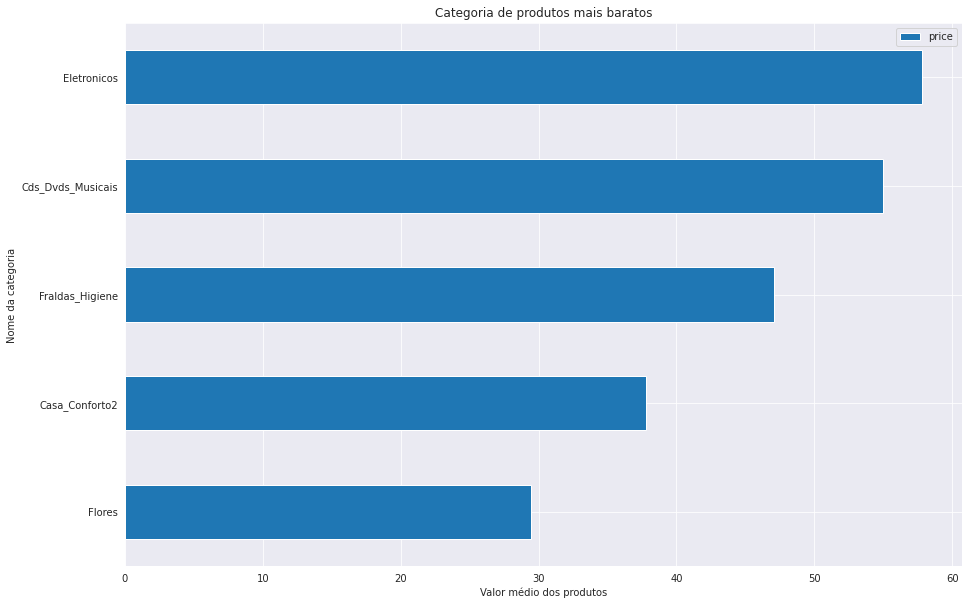

In [47]:
categoria1.plot(kind='barh', figsize=(15,10))
plt.title("Categoria de produtos mais baratos")
plt.ylabel("Nome da categoria")
plt.xlabel("Valor médio dos produtos")

In [48]:
categoria2 = categoria2.rename({68: 'Cozinha_Preparadores', 69: 'Agro_Ind_Comercio', 70: 'Eletrodomesticos2', 71: 'Portateis_Casa_Forno', 72: 'Pcs'})

Text(0.5, 0, 'Valor médio dos produtos')

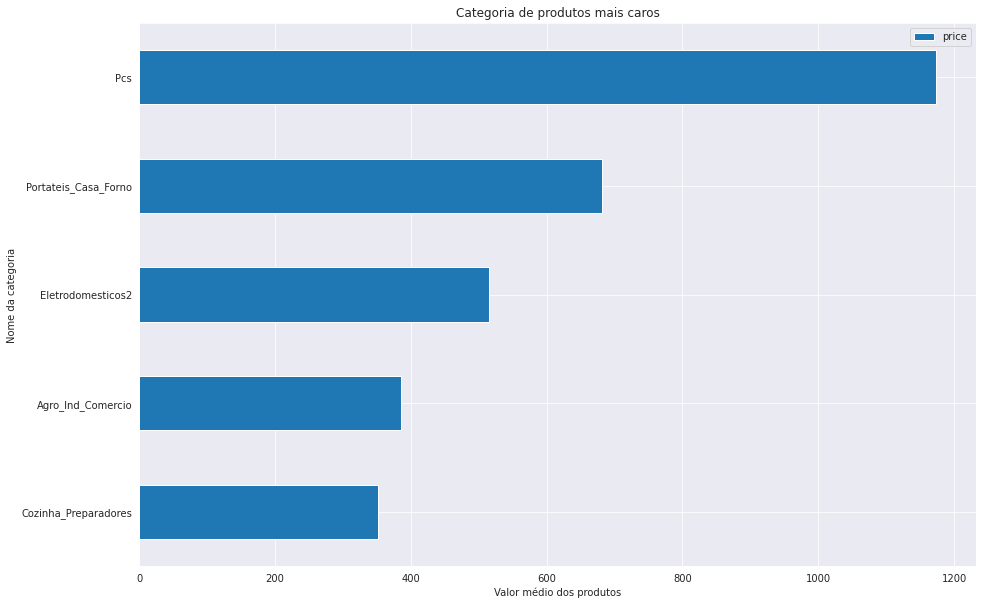

In [49]:
categoria2.plot(kind='barh', figsize=(15,10))
plt.title("Categoria de produtos mais caros")
plt.ylabel("Nome da categoria")
plt.xlabel("Valor médio dos produtos")

Primeiro, modicamos a maneira com que os dados de data dos produtos eram visualizados para o padrão de "Ano, mês, dia" e armazenamos em uma variável. Depois, somamos todas os produtos recorrentes a cada mês com "value_counts" e armazenamos para enfim plotar essa informação em um gráfico.

In [50]:
e_commerce['shipping_limit_month'] = e_commerce['shipping_limit_date'].apply(lambda x:datetime.strptime(x, '%Y-%m-%d %H:%M:%S').strftime('%B-%Y'))

bar = e_commerce['shipping_limit_month'].value_counts()
fig = px.bar(x=bar.index , y=bar.values , text=bar.values , labels={'x':'Meses','y':'Número'})

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside',
                 marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                 marker_line_width=1.5, opacity=.7)

fig.update_layout(title_text='Meses com o maior número de envios')
fig.show()

In [51]:
fig = px.histogram(x=e_commerce['shipping_limit_month'], y=e_commerce['price'],
                  labels={'x':'Mes','y':'Preço'})


fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.7)


fig.update_layout(title_text='Somatório do preço total por mês')

Armazenamos em uma variável o valor médio dos produtos em cada mês e depois plotamos em um gráfico.

In [52]:
fig = px.histogram(x=e_commerce['shipping_limit_month'], y=e_commerce['price'],histfunc='avg',
                  labels={'x':'Mês','y':'Preço'})


fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.7)


fig.update_layout(title_text='Média do preço total em cada mês')

Da mesma forma que se fez com o valor médio, fizemos para o valor mínimo utilizando o parâmetro "histfunc='min'".

In [53]:
fig = px.histogram(x=e_commerce['shipping_limit_month'], y=e_commerce['price'],histfunc='min',
                  labels={'x':'Mes','y':'Preço'})


fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.7)


fig.update_layout(title_text='Preço minimo em cada mês')

Semelhante ao anterior, só que com o valor máximo.

In [54]:
fig = px.histogram(x=e_commerce['shipping_limit_month'], y=e_commerce['price'],histfunc='max',
                   labels={'x':'Mes','y':'Preço'})


fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5, opacity=0.7)


fig.update_layout(title_text='Preço máximo em cada mês')

Puxamos a tabela de reviews do drive.

In [55]:
review = pd.read_csv('/content/drive/My Drive/MABD/E-Commerce/olist_order_reviews_dataset.csv')


Retiramos todas as colunas que decidimos que não vamos usar.

In [56]:
review = review.drop(columns=['review_id'])
review = review.drop(columns=['review_comment_title'])
review = review.drop(columns=['review_comment_message'])
review = review.drop(columns=['review_creation_date'])
review = review.drop(columns=['review_answer_timestamp'])

Verifica se há algum valor nulo nos dados.

In [57]:
review.isnull().sum()

order_id        0
review_score    0
dtype: int64

Visualiza quais as principais informações desse dataframe.

In [58]:
review.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 2 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   order_id      100000 non-null  object
 1   review_score  100000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 1.5+ MB


Junta o dataframe "e_commerce" com o dataframe de reviews, fazendo ligação pela coluna "order_id", que é presente nos dois.

In [59]:
e_commerce = pd.merge(e_commerce, review, how = 'inner', on ='order_id')

In [60]:
e_commerce.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 67442 entries, 0 to 67441
Data columns (total 28 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   customer_id                    67442 non-null  object 
 1   customer_unique_id             67442 non-null  object 
 2   customer_zip_code_prefix       67442 non-null  int64  
 3   customer_city                  67442 non-null  object 
 4   customer_state                 67442 non-null  object 
 5   order_id                       67442 non-null  object 
 6   order_status                   67442 non-null  object 
 7   order_purchase_timestamp       67442 non-null  object 
 8   order_approved_at              67442 non-null  object 
 9   order_delivered_carrier_date   67442 non-null  object 
 10  order_delivered_customer_date  67442 non-null  object 
 11  order_estimated_delivery_date  67442 non-null  object 
 12  product_id                     67442 non-null 

Retira todos os valores nulos após o merge, caso haja algum.

In [61]:
e_commerce.dropna(inplace=True)

In [62]:
e_commerce.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,product_id,product_category_name,order_item_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,seller_zip_code_prefix,seller_city,seller_state,shipping_limit_month,review_score
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,a9516a079e37a9c9c36b9b78b10169e8,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,1,credit_card,2,146.87,8577,itaquaquecetuba,SP,May-2017,4
1,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,bd07b66896d6f1494f5b86251848ced7,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,1,credit_card,7,157.73,8577,itaquaquecetuba,SP,June-2018,5
2,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,a5647c44af977b148e0a3a4751a09e2e,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,1,credit_card,1,173.30,8577,itaquaquecetuba,SP,March-2018,5
3,4c06b42fbf7b97ab10779cda5549cd1c,07d190f123147d9e89d4b922543d7948,65075,sao luis,MA,997fd4b37386d10b57d4ac8cdec011a6,delivered,2018-07-08 09:59:19,2018-07-08 10:30:15,2018-07-25 15:12:00,2018-08-08 19:42:53,2018-08-16 00:00:00,8ed094bfe076c568f6bb10feada3f75d,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-07-26 10:30:15,199.98,115.77,1,credit_card,6,315.75,8577,itaquaquecetuba,SP,July-2018,1
4,fc570b6557c9a63780acb28007d313f0,4274c9d2313a7fbac9703456d8a788f3,4342,sao paulo,SP,a24d08cc90fa49d3bb3be98d915423e3,delivered,2018-02-02 15:52:51,2018-02-03 15:50:17,2018-02-20 21:07:38,2018-02-21 22:46:58,2018-03-09 00:00:00,dbf47a585df3a9d8f0b5f4c125a2b8e8,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-02-16 15:50:17,139.99,18.69,1,credit_card,4,158.68,8577,itaquaquecetuba,SP,February-2018,4


Plota em um gráfico o número de ordens por review, agrupando-se os valores pelo paramêtro "review_score".

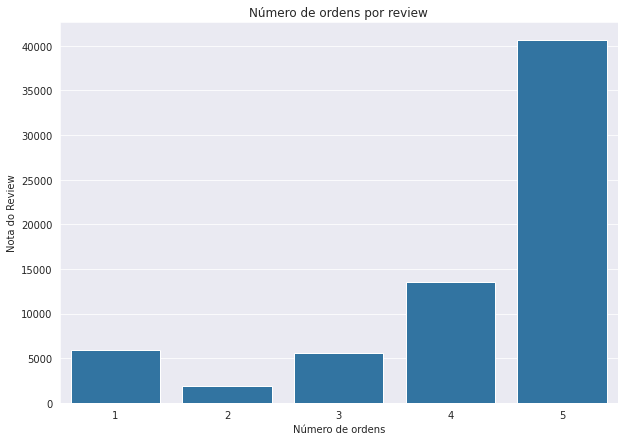

In [63]:
base_color = sns.color_palette()[0]

plt.figure(figsize = (10,7))
sns.barplot(data = e_commerce.groupby('review_score').count()['order_id'].reset_index(), x = 'review_score', y = 'order_id', color = base_color)
plt.title('Número de ordens por review')
plt.xlabel('Número de ordens')
plt.ylabel('Nota do Review');

Visualização do que foi feito anteriormente de outra forma.

In [64]:
data = e_commerce.groupby('review_score').count()['order_id'].reset_index()
data

,review_score,order_id
0,1,5875
1,2,1902
2,3,5550
3,4,13512
4,5,40603


Primeiro, agrupa-se os valores de review por categoria e se faz a média deles, armazenando-se em uma variável. Logo após, utilizamos um "sort" para organizar esses valores em ordem e armazenamos nas variáveis "top_5_ratings" e "lowest_5_ratings" os 5 maiores e menores valores de review, respectivamente. 

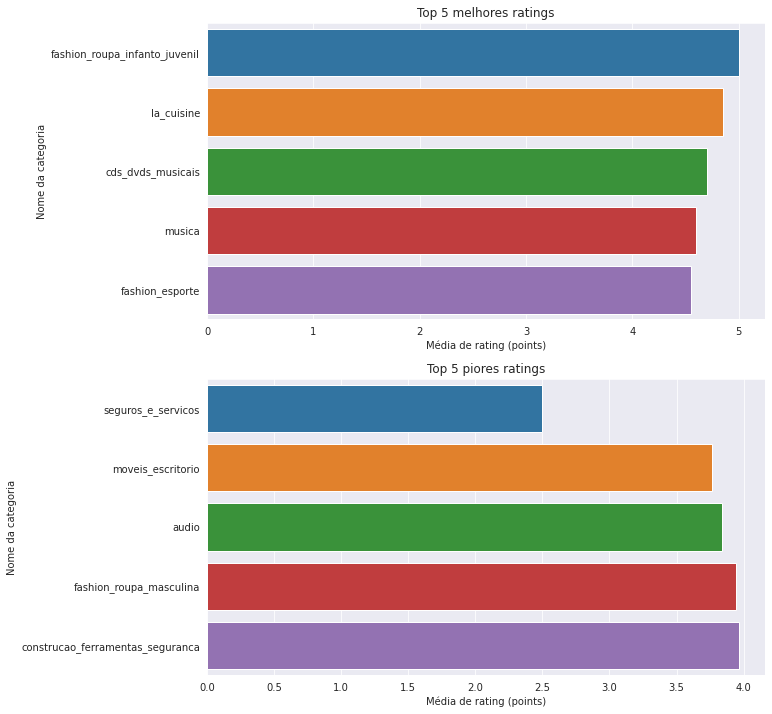

In [65]:
prd_rev_means = e_commerce.groupby('product_category_name').mean()['review_score'].reset_index()
top_5_ratings = prd_rev_means.sort_values('review_score', ascending = False).nlargest(5,'review_score')
lowest_5_ratings = prd_rev_means.sort_values('review_score', ascending = False).nsmallest(5,'review_score')

plt.figure(figsize = (10,12))

sns.barplot(data = e_commerce.groupby('review_score').count()['order_id'].reset_index(), x = 'review_score', y = 'order_id')
plt.title('Order Count by Review Score')
plt.xlabel('Order Count')
plt.ylabel('Review Score')

plt.subplot(211)
sns.barplot(data = top_5_ratings, x = 'review_score', y = 'product_category_name')
plt.title('Top 5 melhores ratings')
plt.xlabel('Média de rating (points)')
plt.ylabel('Nome da categoria');

plt.subplot(212)
sns.barplot(data = lowest_5_ratings, x = 'review_score', y = 'product_category_name')
plt.title('Top 5 piores ratings')
plt.xlabel('Média de rating (points)')
plt.ylabel('Nome da categoria');


Outra forma de visualização do gráfico anterior.


In [67]:
top_5_ratings

,product_category_name,review_score
37,fashion_roupa_infanto_juvenil,5.000000
46,la_cuisine,4.857143
17,cds_dvds_musicais,4.700000
58,musica,4.600000
35,fashion_esporte,4.555556


In [68]:
lowest_5_ratings

,product_category_name,review_score
67,seguros_e_servicos,2.500000
55,moveis_escritorio,3.763708
7,audio,3.838951
38,fashion_roupa_masculina,3.944444
25,construcao_ferramentas_seguranca,3.961905


In [69]:
e_commerce.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,product_id,product_category_name,order_item_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,seller_zip_code_prefix,seller_city,seller_state,shipping_limit_month,review_score
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00,a9516a079e37a9c9c36b9b78b10169e8,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,1,credit_card,2,146.87,8577,itaquaquecetuba,SP,May-2017,4
1,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00,bd07b66896d6f1494f5b86251848ced7,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,1,credit_card,7,157.73,8577,itaquaquecetuba,SP,June-2018,5
2,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00,a5647c44af977b148e0a3a4751a09e2e,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,1,credit_card,1,173.30,8577,itaquaquecetuba,SP,March-2018,5
3,4c06b42fbf7b97ab10779cda5549cd1c,07d190f123147d9e89d4b922543d7948,65075,sao luis,MA,997fd4b37386d10b57d4ac8cdec011a6,delivered,2018-07-08 09:59:19,2018-07-08 10:30:15,2018-07-25 15:12:00,2018-08-08 19:42:53,2018-08-16 00:00:00,8ed094bfe076c568f6bb10feada3f75d,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-07-26 10:30:15,199.98,115.77,1,credit_card,6,315.75,8577,itaquaquecetuba,SP,July-2018,1
4,fc570b6557c9a63780acb28007d313f0,4274c9d2313a7fbac9703456d8a788f3,4342,sao paulo,SP,a24d08cc90fa49d3bb3be98d915423e3,delivered,2018-02-02 15:52:51,2018-02-03 15:50:17,2018-02-20 21:07:38,2018-02-21 22:46:58,2018-03-09 00:00:00,dbf47a585df3a9d8f0b5f4c125a2b8e8,moveis_escritorio,1,7c67e1448b00f6e969d365cea6b010ab,2018-02-16 15:50:17,139.99,18.69,1,credit_card,4,158.68,8577,itaquaquecetuba,SP,February-2018,4


"Ibitinga" foi uma cidade apontada como uma das que mais vendeu segundo o overview, o que é um fato interessante. Aqui, verificamos qual a categoria de produtos mais vendido nessa cidade.

In [82]:
e_commerce.loc[e_commerce['seller_city'] == 'ibitinga'] ['product_category_name'].value_counts()

cama_mesa_banho                  3341
moveis_decoracao                  537
casa_conforto                     128
bebes                              88
brinquedos                         37
utilidades_domesticas              23
automotivo                         16
casa_conforto_2                    13
fashion_roupa_masculina            12
fashion_roupa_feminina              7
moveis_sala                         7
pet_shop                            4
alimentos                           3
cool_stuff                          3
malas_acessorios                    2
relogios_presentes                  2
construcao_ferramentas_jardim       1
Name: product_category_name, dtype: int64